# DINO object detection model on a pedestrian dataset
Pedestrian Detection on Custom Dataset using an Attention Based Transformer Technique.


## Dataset Preparation:
Split the dataset into two sets: a training set with 160 images and a validation set with 40 images.

In [ ]:
# performed on local machine to split into coco format

# custom_dataset/
#   ├── train_images/
#   ├── val_images/
#   └── annotations/
#   	├── instances_train_imagesd.json
#   	└── instances_val_images.json

## Setup of DINO reposatory
Clone the DINO repository from this link and set up the necessary environment and dependencies as outlined in the repository instructions.

follow : [installation](https://github.com/IDEA-Research/DINO/blob/main/README.md#installation)

In [ ]:
!git clone https://github.com/IDEA-Research/DINO.git

Cloning into 'DINO'...
remote: Enumerating objects: 442, done.
remote: Counting objects: 100% (191/191), done.
remote: Compressing objects: 100% (95/95), done.
remote: Total 442 (delta 136), reused 96 (delta 96), pack-reused 251 (from 1)
Receiving objects: 100% (442/442), 13.43 MiB | 26.76 MiB/s, done.
Resolving deltas: 100% (191/191), done.


In [ ]:
!mv -v /content/DINO/* /content/

renamed '/content/DINO/config' -> '/content/config'
renamed '/content/DINO/datasets' -> '/content/datasets'
renamed '/content/DINO/engine.py' -> '/content/engine.py'
renamed '/content/DINO/figs' -> '/content/figs'
renamed '/content/DINO/inference_and_visualization.ipynb' -> '/content/inference_and_visualization.ipynb'
renamed '/content/DINO/LICENSE' -> '/content/LICENSE'
renamed '/content/DINO/main.py' -> '/content/main.py'
renamed '/content/DINO/models' -> '/content/models'
renamed '/content/DINO/README.md' -> '/content/README.md'
renamed '/content/DINO/requirements.txt' -> '/content/requirements.txt'
renamed '/content/DINO/run_with_submitit.py' -> '/content/run_with_submitit.py'
renamed '/content/DINO/scripts' -> '/content/scripts'
renamed '/content/DINO/tools' -> '/content/tools'
renamed '/content/DINO/util' -> '/content/util'


In [ ]:
!rm -rf /content/DINO

In [ ]:
import torch
import torchvision

In [ ]:
!pip install -r requirements.txt

  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-install-7dwnc3ja/pycocotools_658f59e0a3f843e1b1067a3907f4dfd6
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-install-7dwnc3ja/pycocotools_658f59e0a3f843e1b1067a3907f4dfd6
  Resolved https://github.com/cocodataset/cocoapi.git to commit 8c9bcc3cf640524c4c20a9c40e89cb6a2f2fa0e9
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/cocodataset/panopticapi.git to /tmp/pip-install-7dwnc3ja/panopticapi_667596695a8f4e598194abc4bf5f5cbd
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/panopticapi.git /tmp/pip-install-7dwnc3ja/panopticapi_667596695a8f4e598194abc4bf5f5cbd
  Resolved https://github.com/cocodataset/panopticapi.git to commit 7bb4655548f98f3fedc07bf37e9040a992b054b0
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 2.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━

In [ ]:
!python models/dino/ops/setup.py build install

running build
running build_py
creating build
creating build/lib.linux-x86_64-cpython-310
creating build/lib.linux-x86_64-cpython-310/datasets
copying datasets/random_crop.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/sltransform.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/panoptic_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/data_util.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/dataset.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/__init__.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/transforms.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_panoptic.py -> build/lib.linux-x86_64-cpython-310/datasets
creating build/lib.linux-x86_64-cpython-310/util
copying util/box_loss.py -> build

In [ ]:
!python models/dino/ops/test.py

* True check_forward_equal_with_pytorch_double: max_abs_err 8.67e-19 max_rel_err 2.35e-16
* True check_forward_equal_with_pytorch_float: max_abs_err 4.66e-10 max_rel_err 1.13e-07
* True check_gradient_numerical(D=30)
* True check_gradient_numerical(D=32)
* True check_gradient_numerical(D=64)
* True check_gradient_numerical(D=71)
* True check_gradient_numerical(D=1025)
Traceback (most recent call last):
  File "/content/models/dino/ops/test.py", line 86, in <module>
    check_gradient_numerical(channels, True, True, True)
  File "/content/models/dino/ops/test.py", line 76, in check_gradient_numerical
    gradok = gradcheck(func, (value.double(), shapes, level_start_index, sampling_locations.double(), attention_weights.double(), im2col_step))
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2053, in gradcheck
    return _gradcheck_helper(**args)
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2082, in _gradcheck_helper


#### NOTE: Last test failed due to OutOfMemoryError: CUDA out of memory. Tried to allocate 7.50 GiB. GPU 0

#### Installation Done ✅

## Download Pretrained model (R50, 4scale) --- Uploaded from drive

Download the pre-trained DINO-4scale model with the ResNet-50 (R50) backbone from the provided link in the repository.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!cp -r /content/drive/MyDrive/Vision_Internship/checkpoint0011_4scale.pth /content/

### Run on Custom Dataset for Validation

* Run evaluations on the validation set using the pre-trained weights, as COCO contains a "person" class relevant to this task.

* Need to import custom_dataset from the drive that was uploaded after creating with the help of train_val script on local machine

In [ ]:
# Custom Dataset Import
!cp -r /content/drive/MyDrive/Vision_Internship/custom_dataset.zip /content/

In [ ]:
!unzip /content/custom_dataset.zip > /dev/null

In [ ]:
# !rm -r custom_dataset.zip


#### Validation

In [ ]:
!pip install yapf==0.40.1

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.3/250.3 kB 10.1 MB/s eta 0:00:00
  Attempting uninstall: yapf
    Found existing installation: yapf 0.40.2
    Uninstalling yapf-0.40.2:
      Successfully uninstalled yapf-0.40.2


In [ ]:
import numpy as np
np.__version__


'1.26.4'

In [ ]:
!grep -rnw '/content/' -e 'np.float'

grep: /content/drive/MyDrive/Untitled form (1).gform: Operation not supported
grep: /content/drive/MyDrive/Untitled form.gform: Operation not supported
grep: /content/drive/MyDrive/Contact Information.gform: Operation not supported
grep: /content/drive/MyDrive/Untitled document (1).gdoc: Operation not supported
grep: /content/drive/MyDrive/Untitled document.gdoc: Operation not supported
grep: /content/drive/MyDrive/1_unit_15x15_2_goldenFmt.gdoc: Operation not supported
/content/drive/MyDrive/Colab Notebooks/VisionLab_Assignment_pedestrian_detection.ipynb:1:{"metadata":{"kernelspec":{"display_name":"Python 3","name":"python3"},"language_info":{"pygments_lexer":"ipython3","nbconvert_exporter":"python","version":"3.6.4","file_extension":".py","codemirror_mode":{"name":"ipython","version":3},"name":"python","mimetype":"text/x-python"},"colab":{"provenance":[],"gpuType":"T4"},"accelerator":"GPU"},"nbformat_minor":0,"nbformat":4,"cells":[{"cell_type":"markdown","source":["# DINO  \n"],"metad

In [ ]:
!pip install "numpy<1.24"

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 55.1 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albucore 0.0.16 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.
albumentations 1.4.15 requires numpy>=1.24.4, but you have numpy 1.23.5 which is incompatible.
bigframes 1.17.0 requires numpy>=1.24.0, but you have numpy 1.23.5 which is incompatible.
chex 0.1.86 requires numpy>=1.24.1, but you have numpy 1.23.5 which is incompatible.
pandas-stubs 2.1.4.231227 requires numpy>=1.26.0; python_version < "3.13", but you have numpy 1.23.5 which is incompatible.
xarray 2024.9.0 requires numpy>=1.24, but you have numpy 1.23.5 which is incompatible.


In [ ]:
# change the coco.py file from dataset folder

# change the coco dir details

# def build(image_set, args):
#     root = Path(args.coco_path)
#     mode = 'instances'
#     PATHS = {
#         "train": (root / "train_images", root / "annotations" / f'{mode}_train_images.json'),
#         "train_reg": (root / "train_images", root / "annotations" / f'{mode}_train_images.json'),
#         "val": (root / "val_images", root / "annotations" / f'{mode}_val_images.json'),
#         "eval_debug": (root / "val_images", root / "annotations" / f'{mode}_val_images.json'),
#         "test": (root / "test_images", root / "annotations" / 'image_info_test-images.json' ),
#     }

In [ ]:
# evaluate on custom dataset
!bash /content/scripts/DINO_eval.sh /content/custom_dataset /content/checkpoint0011_4scale.pth

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/24 06:30:37.841]: git:
  sha: N/A, status: clean, branch: N/A

[09/24 06:30:37.841]: Command: main.py --output_dir logs/DINO/R50-MS4-%j -c config/DINO/DINO_4scale.py --coco_path /content/custom_dataset --eval --resume /content/checkpoint0011_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/24 06:30:37.841]: Full config saved to logs/DINO/R50-MS4-%j/config_args_all.json
[09/24 06:30:37.841]: world size: 1
[09/24 06:30:37.841]: rank: 0
[09/24 06:30:37.841]: local_rank: 0
[09/24 06:30:37.842]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', coco_path='/content/custom_dataset', coco_panoptic_

Validation(Evaluation) Results
* Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.528
* Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.882
* Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.593
* Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.427
* Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.640
* Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.657
* Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.113
* Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.556
* Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.618
* Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.554
* Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.703
* Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.712

## Visualizations of evalutaions (and Observations)  


In [ ]:
!rm -r /content/figs/pre_trained_model_person_inference

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
<ipython-input-26-141c05f3e86f>:19: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more detai

data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


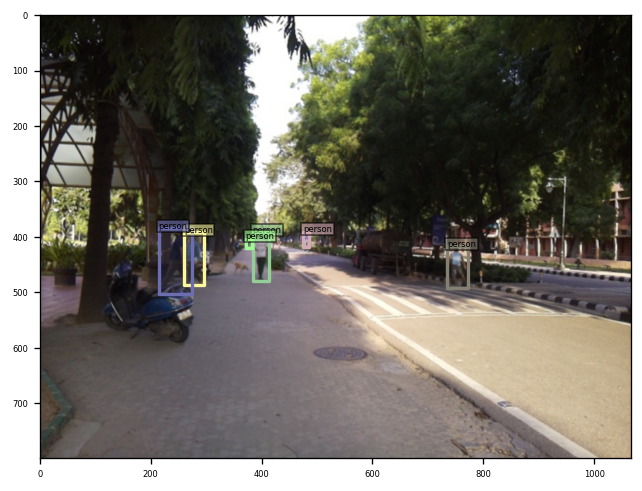

savename: /content/figs/pre_trained_model_person_inference/pred_0000-18-2024-09-24-07:04:07.106218.png


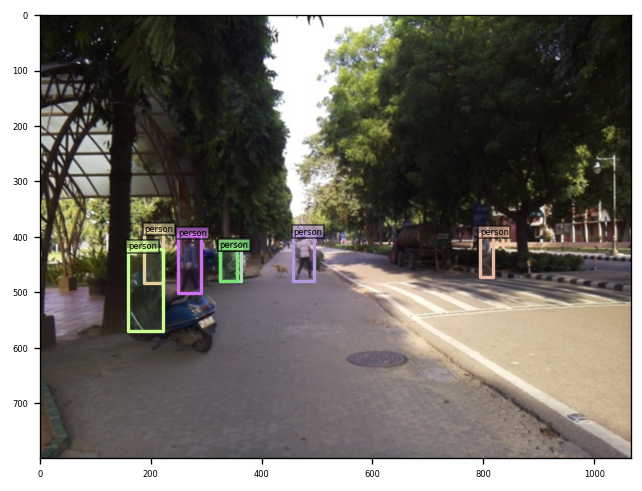

savename: /content/figs/pre_trained_model_person_inference/pred_0001-19-2024-09-24-07:04:07.812466.png


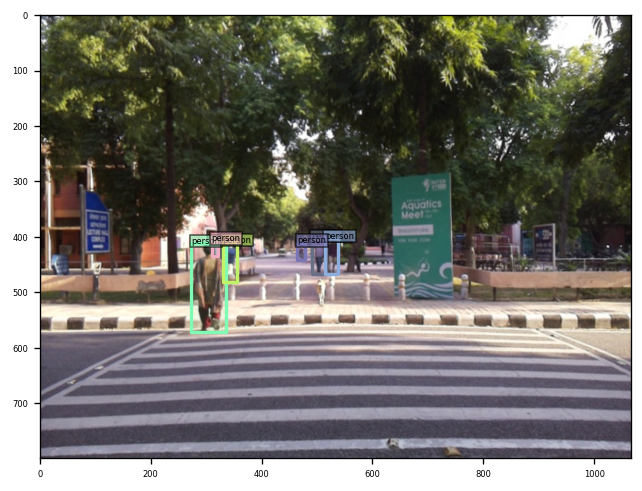

savename: /content/figs/pre_trained_model_person_inference/pred_0002-23-2024-09-24-07:04:08.513381.png


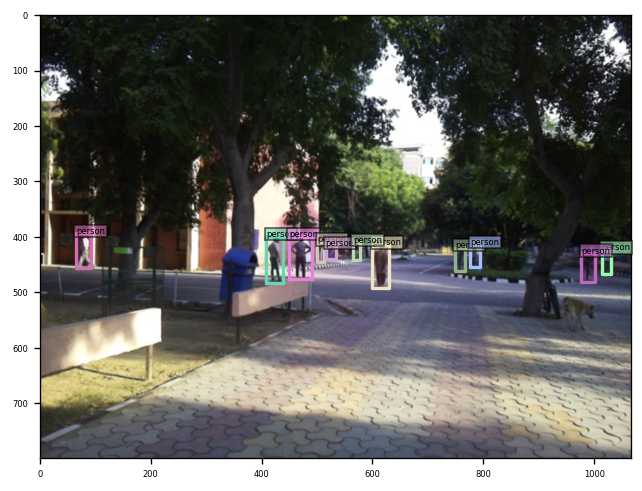

savename: /content/figs/pre_trained_model_person_inference/pred_0003-29-2024-09-24-07:04:09.237877.png


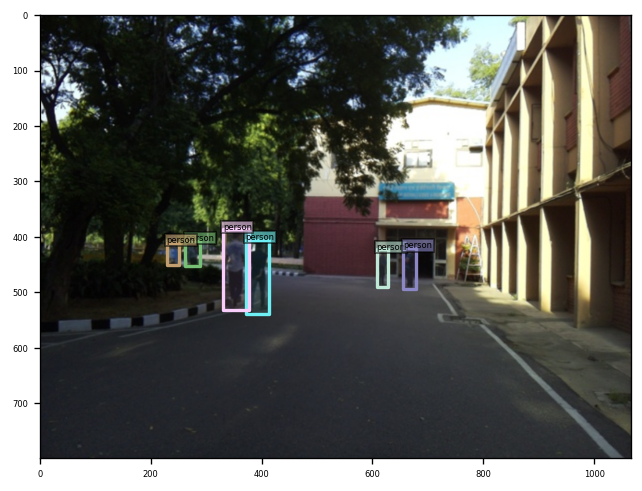

savename: /content/figs/pre_trained_model_person_inference/pred_0004-31-2024-09-24-07:04:09.956362.png


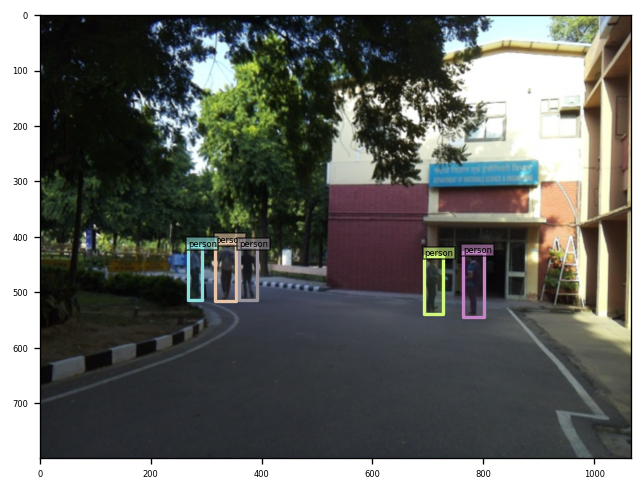

savename: /content/figs/pre_trained_model_person_inference/pred_0005-32-2024-09-24-07:04:10.638137.png


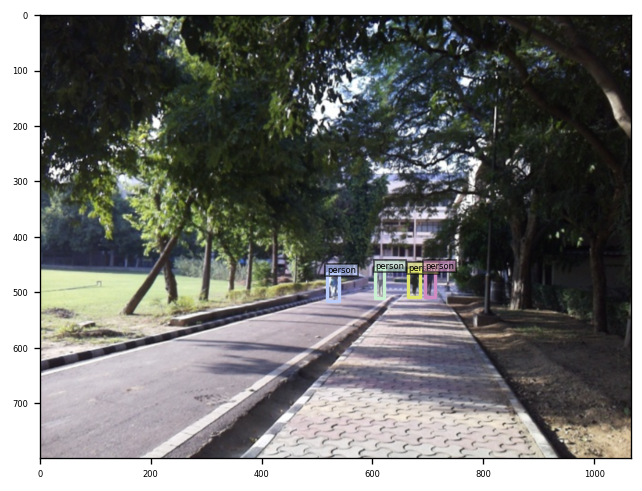

savename: /content/figs/pre_trained_model_person_inference/pred_0006-37-2024-09-24-07:04:11.365460.png


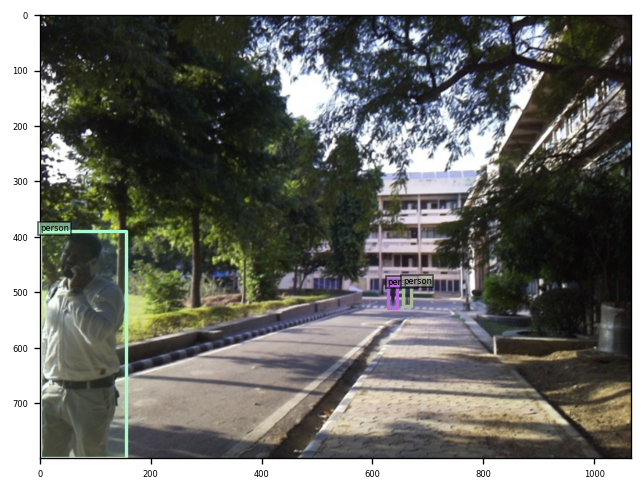

savename: /content/figs/pre_trained_model_person_inference/pred_0007-39-2024-09-24-07:04:12.079330.png


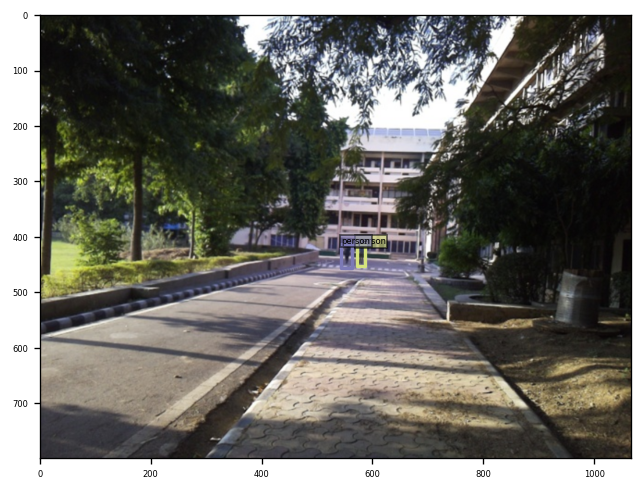

savename: /content/figs/pre_trained_model_person_inference/pred_0008-40-2024-09-24-07:04:12.772880.png


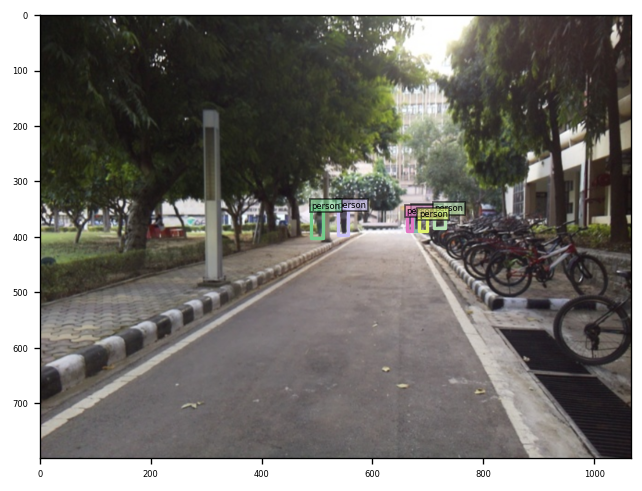

savename: /content/figs/pre_trained_model_person_inference/pred_0009-47-2024-09-24-07:04:13.488161.png


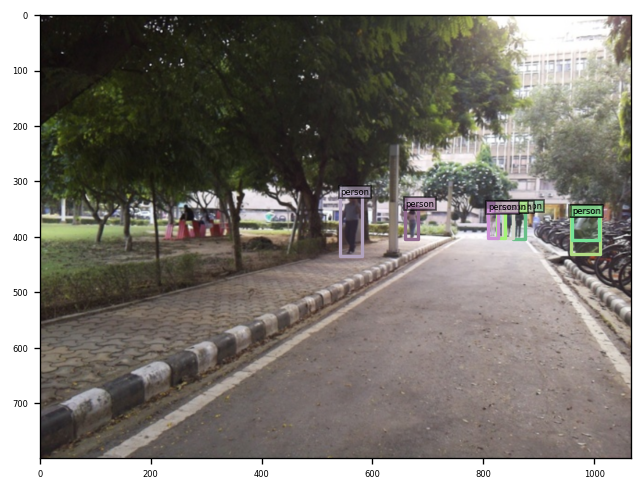

savename: /content/figs/pre_trained_model_person_inference/pred_0010-48-2024-09-24-07:04:14.222996.png


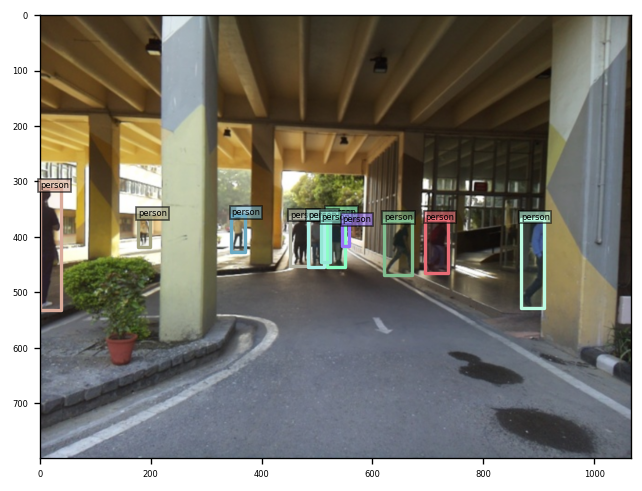

savename: /content/figs/pre_trained_model_person_inference/pred_0011-58-2024-09-24-07:04:15.177981.png


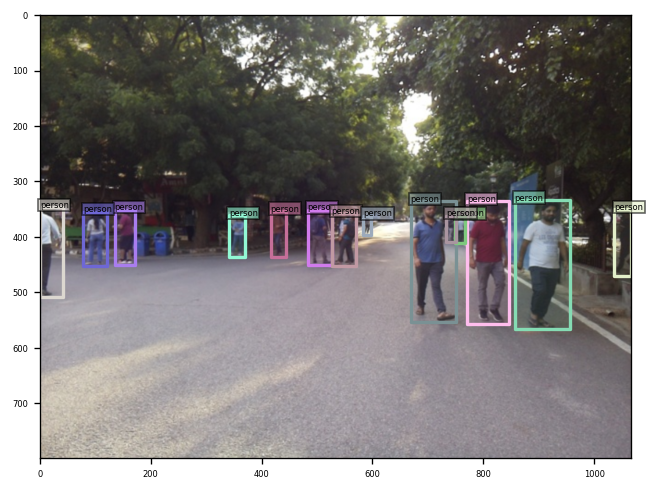

savename: /content/figs/pre_trained_model_person_inference/pred_0012-63-2024-09-24-07:04:16.173433.png


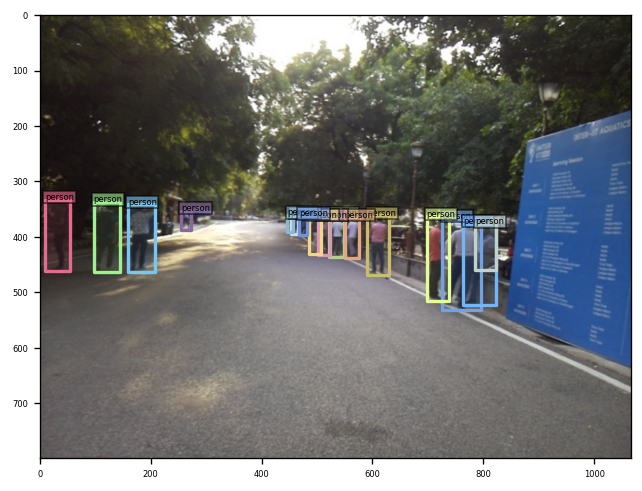

savename: /content/figs/pre_trained_model_person_inference/pred_0013-65-2024-09-24-07:04:17.131521.png


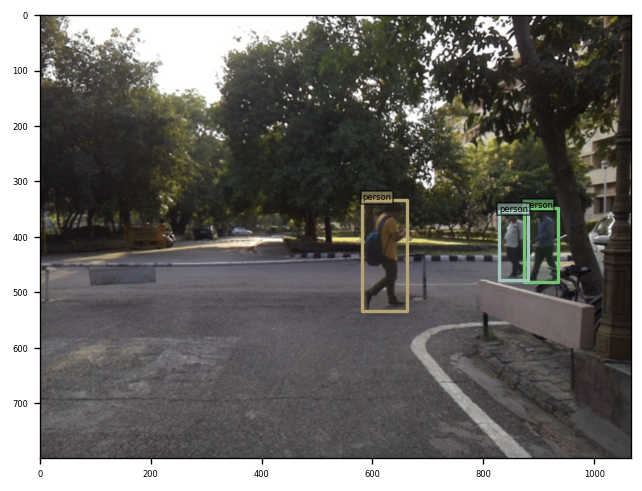

savename: /content/figs/pre_trained_model_person_inference/pred_0014-72-2024-09-24-07:04:18.072096.png


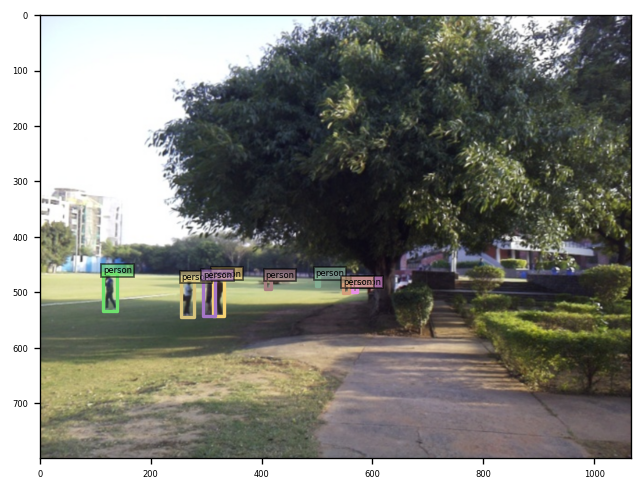

savename: /content/figs/pre_trained_model_person_inference/pred_0015-79-2024-09-24-07:04:19.007381.png


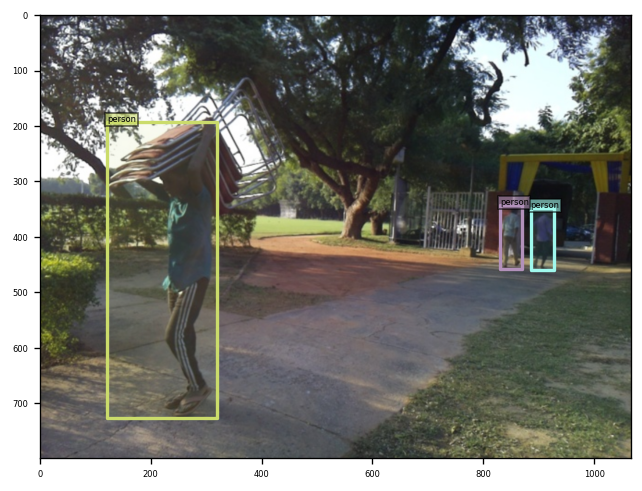

savename: /content/figs/pre_trained_model_person_inference/pred_0016-85-2024-09-24-07:04:19.916232.png


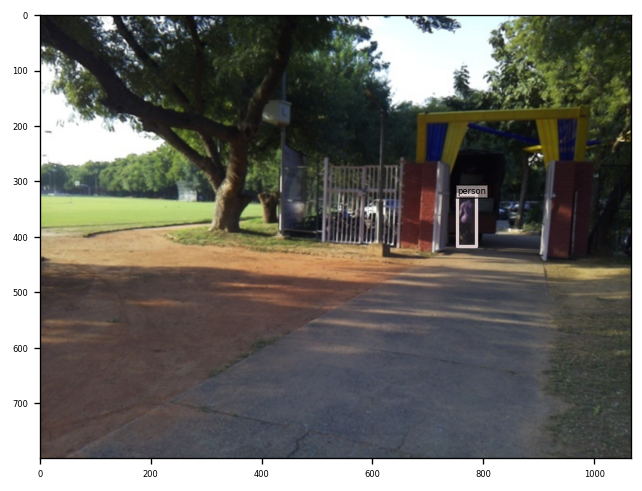

savename: /content/figs/pre_trained_model_person_inference/pred_0017-88-2024-09-24-07:04:20.624323.png


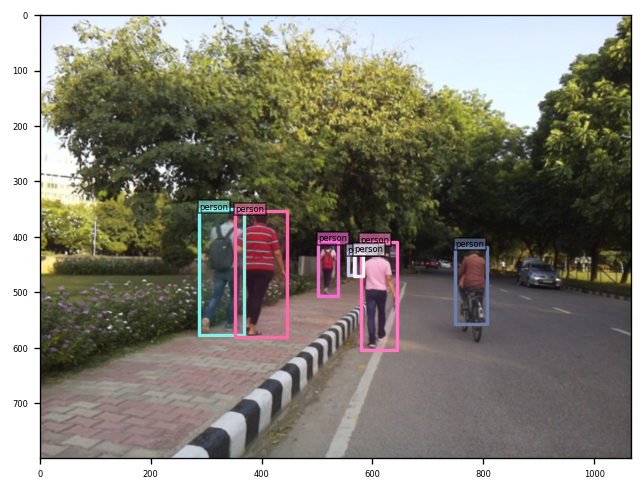

savename: /content/figs/pre_trained_model_person_inference/pred_0018-96-2024-09-24-07:04:21.405210.png


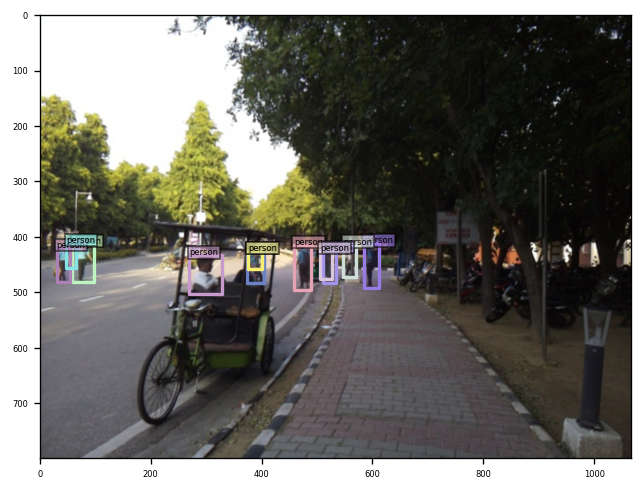

savename: /content/figs/pre_trained_model_person_inference/pred_0019-103-2024-09-24-07:04:22.145216.png


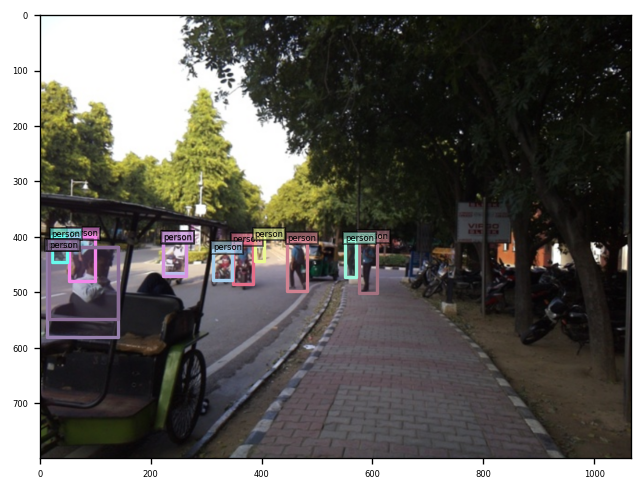

savename: /content/figs/pre_trained_model_person_inference/pred_0020-106-2024-09-24-07:04:22.880229.png


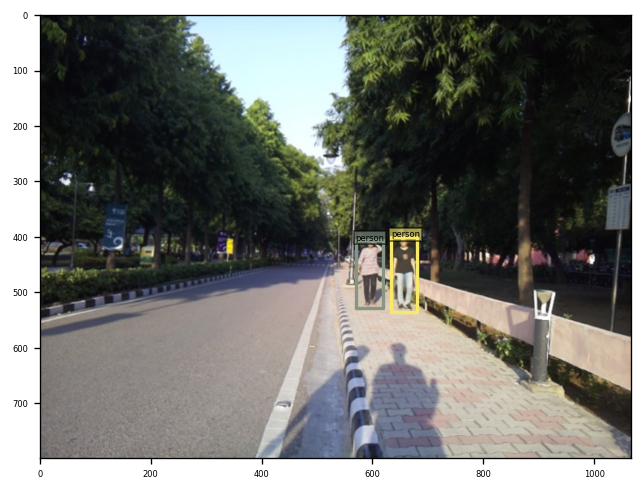

savename: /content/figs/pre_trained_model_person_inference/pred_0021-119-2024-09-24-07:04:23.677167.png


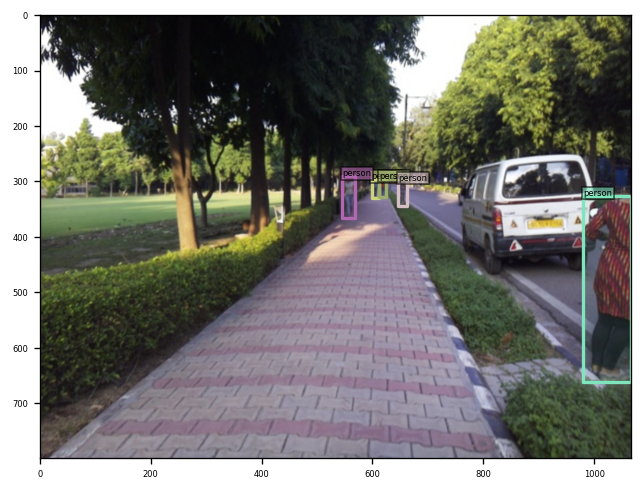

savename: /content/figs/pre_trained_model_person_inference/pred_0022-131-2024-09-24-07:04:24.408839.png


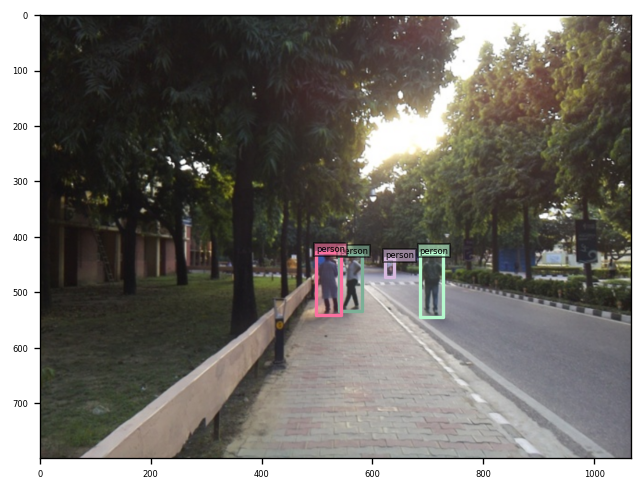

savename: /content/figs/pre_trained_model_person_inference/pred_0023-134-2024-09-24-07:04:25.168022.png


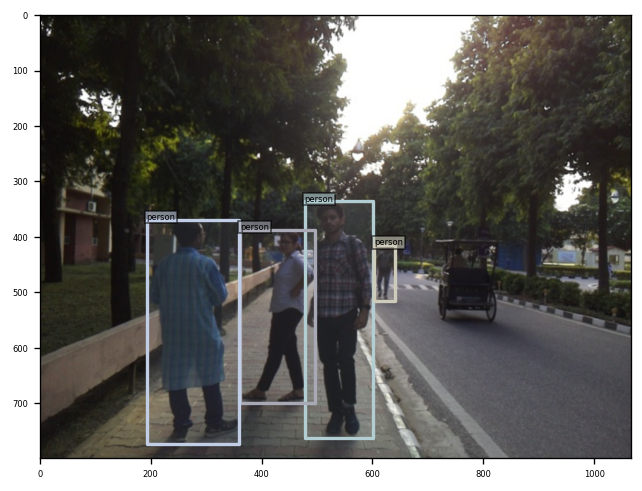

savename: /content/figs/pre_trained_model_person_inference/pred_0024-135-2024-09-24-07:04:25.967575.png


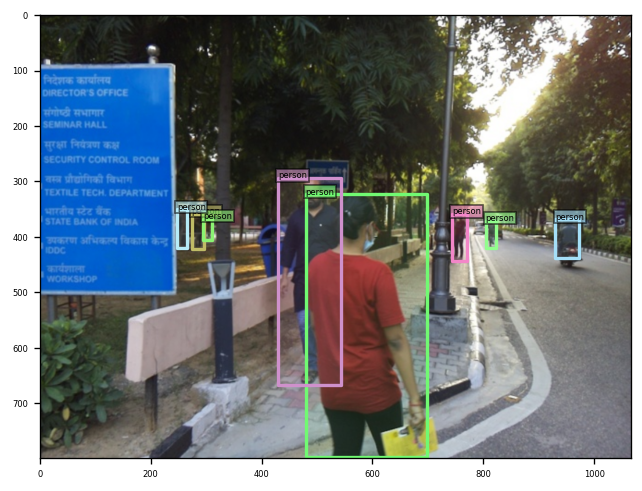

savename: /content/figs/pre_trained_model_person_inference/pred_0025-142-2024-09-24-07:04:26.752035.png


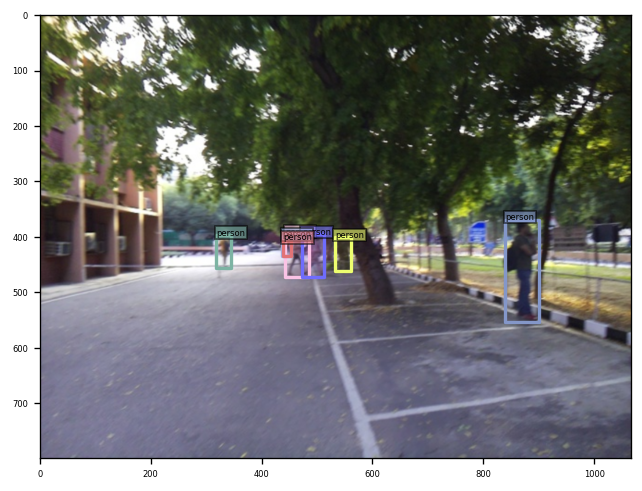

savename: /content/figs/pre_trained_model_person_inference/pred_0026-149-2024-09-24-07:04:27.514881.png


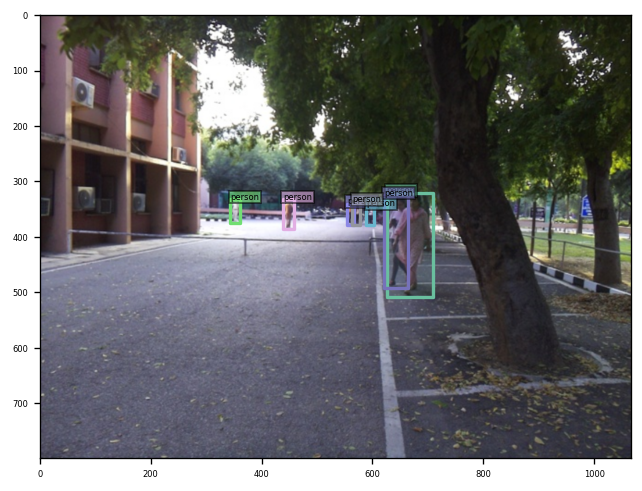

savename: /content/figs/pre_trained_model_person_inference/pred_0027-151-2024-09-24-07:04:28.313482.png


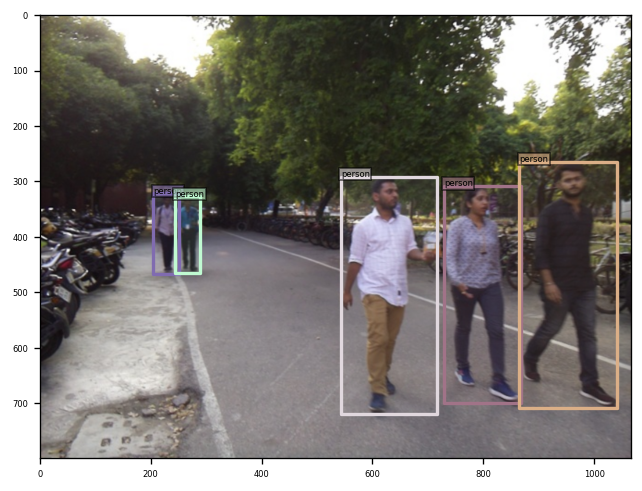

savename: /content/figs/pre_trained_model_person_inference/pred_0028-153-2024-09-24-07:04:29.097438.png


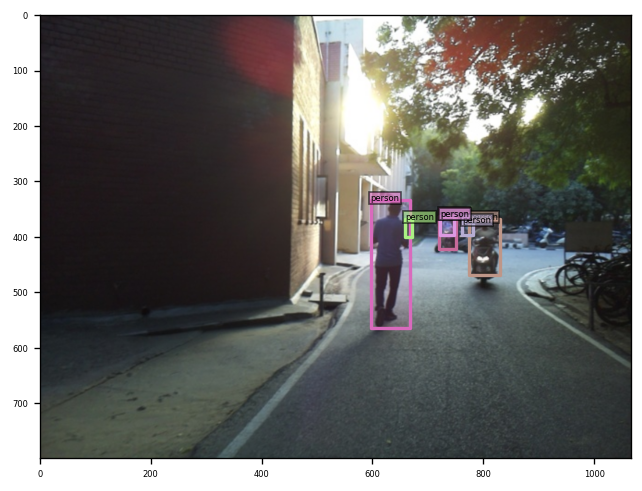

savename: /content/figs/pre_trained_model_person_inference/pred_0029-157-2024-09-24-07:04:29.899508.png


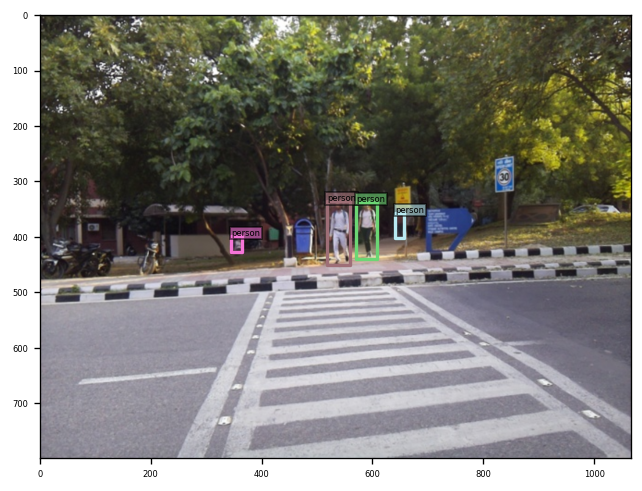

savename: /content/figs/pre_trained_model_person_inference/pred_0030-161-2024-09-24-07:04:30.835322.png


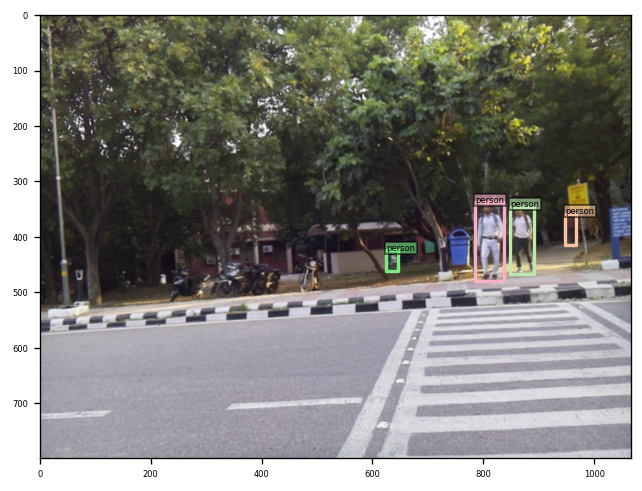

savename: /content/figs/pre_trained_model_person_inference/pred_0031-164-2024-09-24-07:04:31.856622.png


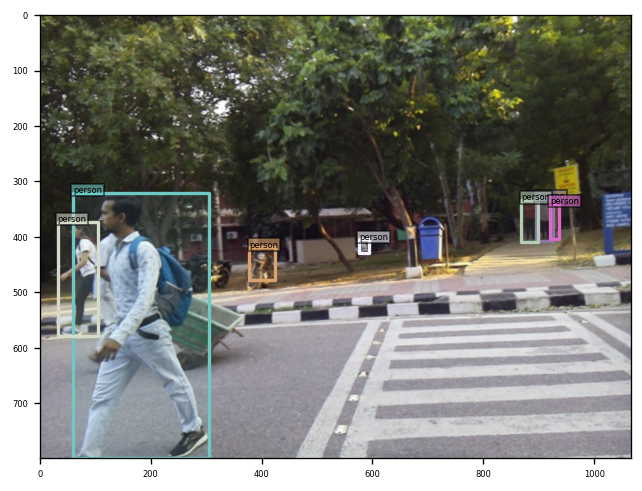

savename: /content/figs/pre_trained_model_person_inference/pred_0032-169-2024-09-24-07:04:32.796822.png


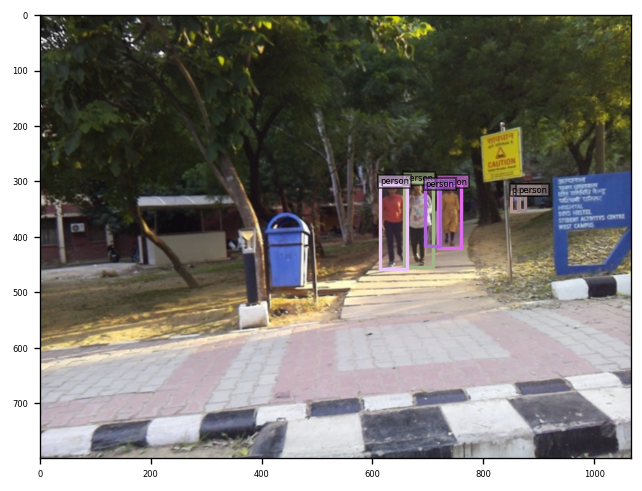

savename: /content/figs/pre_trained_model_person_inference/pred_0033-174-2024-09-24-07:04:33.756704.png


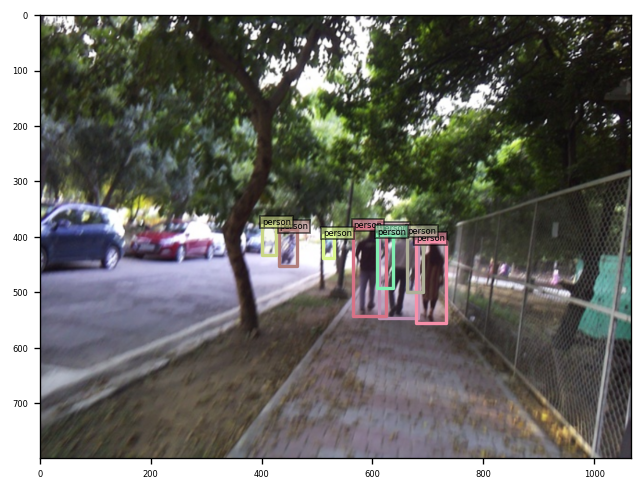

savename: /content/figs/pre_trained_model_person_inference/pred_0034-186-2024-09-24-07:04:35.235988.png


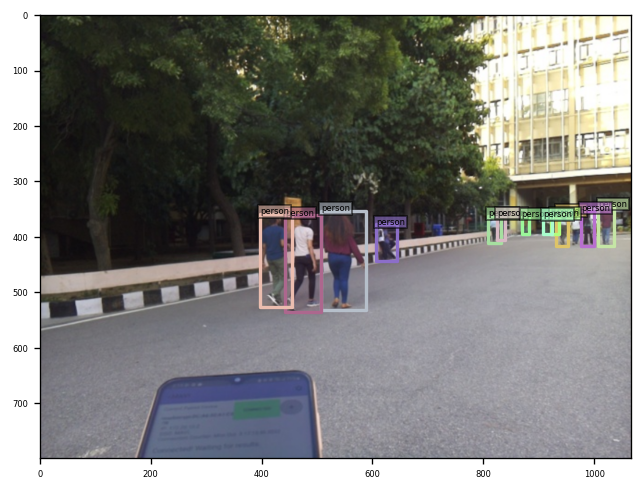

savename: /content/figs/pre_trained_model_person_inference/pred_0035-191-2024-09-24-07:04:36.265821.png


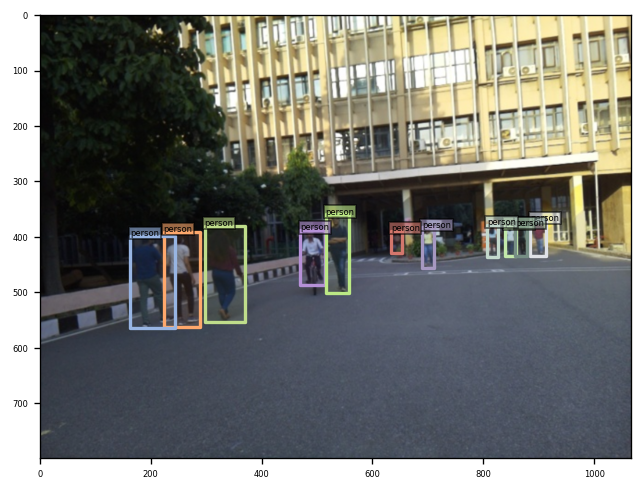

savename: /content/figs/pre_trained_model_person_inference/pred_0036-195-2024-09-24-07:04:37.179125.png


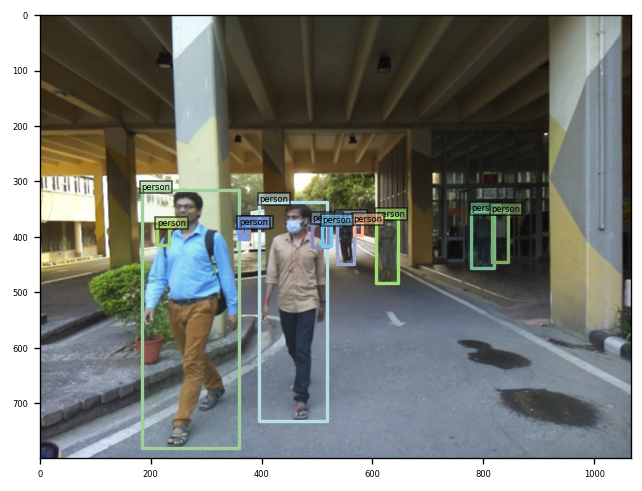

savename: /content/figs/pre_trained_model_person_inference/pred_0037-196-2024-09-24-07:04:38.008524.png


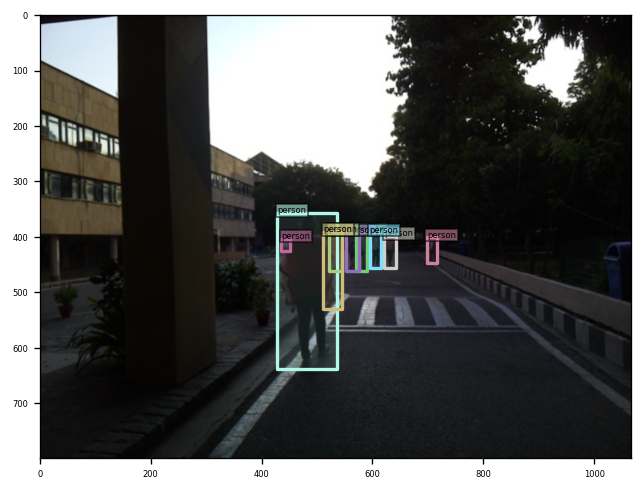

savename: /content/figs/pre_trained_model_person_inference/pred_0038-197-2024-09-24-07:04:38.864849.png


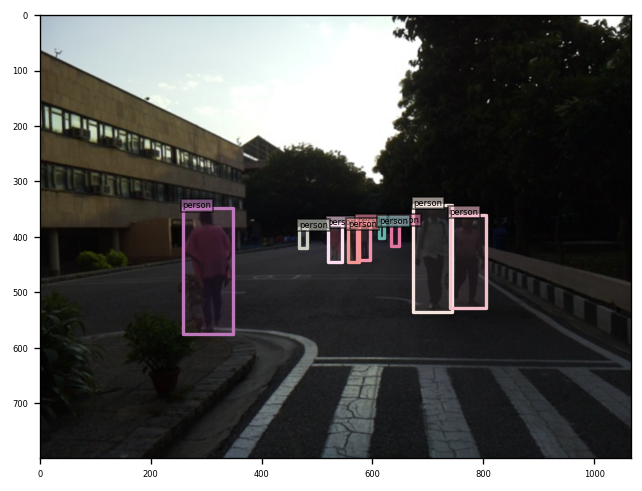

savename: /content/figs/pre_trained_model_person_inference/pred_0039-199-2024-09-24-07:04:39.653078.png
Error idx: 40


In [ ]:
# only making infernce for the person class from the pre-trained model

import os, sys
import torch, json
import numpy as np

from main import build_model_main
from util.slconfig import SLConfig
from datasets import build_dataset
from util.visualizer import COCOVisualizer
from util import box_ops

model_config_path = "/content/config/DINO/DINO_4scale.py"  # Path to the model config file
model_checkpoint_path = "/content/checkpoint0011_4scale.pth"

args = SLConfig.fromfile(model_config_path)
args.device = 'cuda'
model, criterion, postprocessors = build_model_main(args)
checkpoint = torch.load(model_checkpoint_path, map_location='cpu')
model.load_state_dict(checkpoint['model'])
_ = model.eval()

# Load COCO names
with open('util/coco_id2name.json') as f:
    id2name = json.load(f)
    id2name = {int(k): v for k, v in id2name.items()}


# Load Datasets
args.dataset_file = 'coco'
args.coco_path = "/content/custom_dataset"  # The path of coco or your custom dataset
args.fix_size = False

dataset_val = build_dataset(image_set='val', args=args)

for i,batch in enumerate(dataset_val):
    image, targets = batch
    output = model.cuda()(image[None].cuda())
    output = postprocessors['bbox'](output, torch.Tensor([[1.0, 1.0]]).cuda())[0]
    threshold = 0.3  # Set a threshold

    scores = output['scores']
    labels = output['labels']
    boxes = box_ops.box_xyxy_to_cxcywh(output['boxes'])

    # Only select "person" class (class ID 1 in COCO)
    person_class_id = 1
    select_mask = (scores > threshold) & (labels == person_class_id)

    box_label = [id2name[int(item)] for item in labels[select_mask]]
    pred_dict = {
        'boxes': boxes[select_mask],
        'image_id': targets['image_id'],
        'size': targets['size'],
        'box_label': box_label
    }

    vslzr = COCOVisualizer()
    vslzr.visualize(image, pred_dict,caption=f"pred_{str(i).zfill(4)}",savedir='/content/figs/pre_trained_model_person_inference')


## Fine-tuning on the training set
added two more arguments in the config/DINO/DINO_4scale.py
> --finetune_ignore label_enc.weight class_embed

> --pretrain_model_path /content/checkpoint0011_4scale.pth

In [ ]:
!bash scripts/DINO_train.sh /content/custom_dataset

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/24 07:33:28.343]: git:
  sha: N/A, status: clean, branch: N/A

[09/24 07:33:28.343]: Command: main.py --output_dir output/DINO/R50-MS4 -c config/DINO/DINO_4scale.py --coco_path /content/custom_dataset --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0 --finetune_ignore label_enc.weight class_embed --pretrain_model_path /content/checkpoint0011_4scale.pth
[09/24 07:33:28.343]: Full config saved to output/DINO/R50-MS4/config_args_all.json
[09/24 07:33:28.343]: world size: 1
[09/24 07:33:28.343]: rank: 0
[09/24 07:33:28.343]: local_rank: 0
[09/24 07:33:28.343]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', 

---     

---    

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
<ipython-input-13-66db0ecc2bab>:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more detai

data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


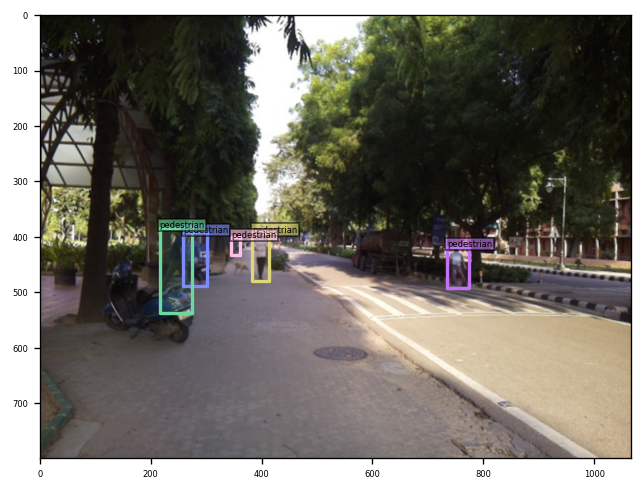

savename: /content/figs/finetuned_model_person_inference/pred_0000.png-18-2024-09-24-08:12:06.048953.png


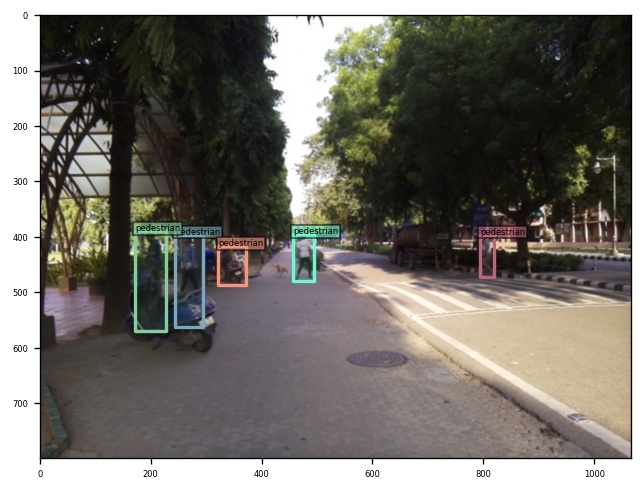

savename: /content/figs/finetuned_model_person_inference/pred_0001.png-19-2024-09-24-08:12:06.737086.png


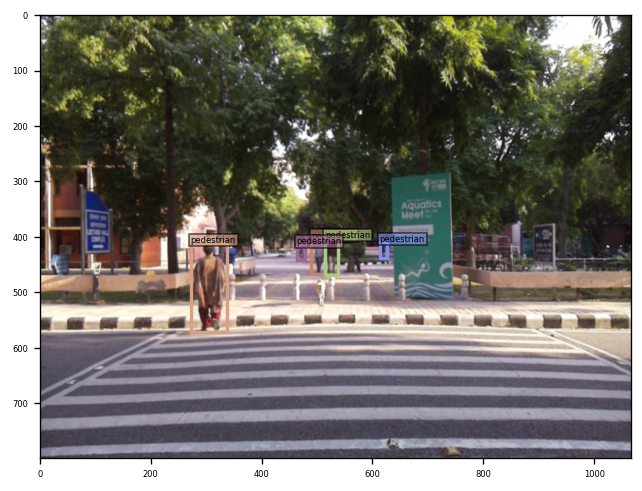

savename: /content/figs/finetuned_model_person_inference/pred_0002.png-23-2024-09-24-08:12:07.440179.png


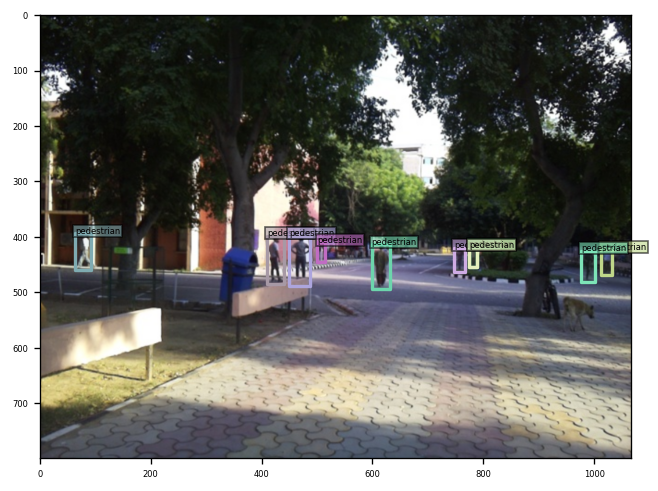

savename: /content/figs/finetuned_model_person_inference/pred_0003.png-29-2024-09-24-08:12:08.173919.png


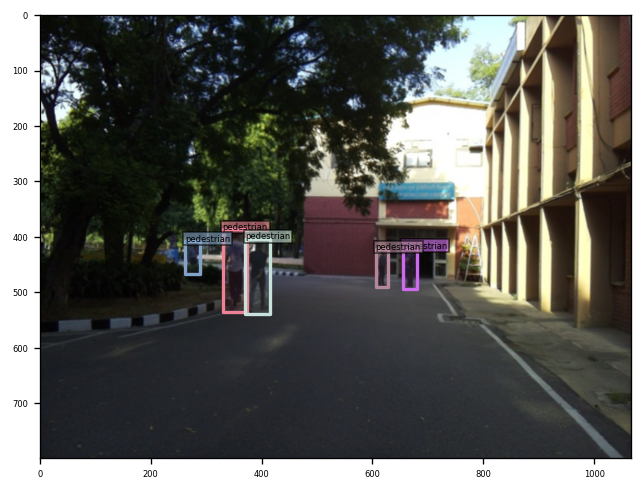

savename: /content/figs/finetuned_model_person_inference/pred_0004.png-31-2024-09-24-08:12:08.859830.png


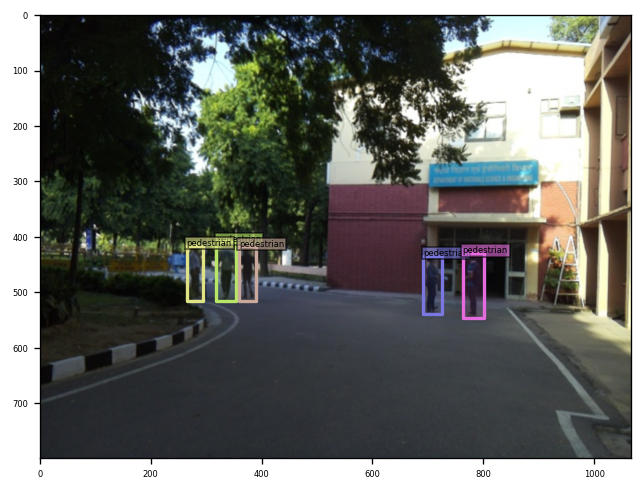

savename: /content/figs/finetuned_model_person_inference/pred_0005.png-32-2024-09-24-08:12:09.531708.png


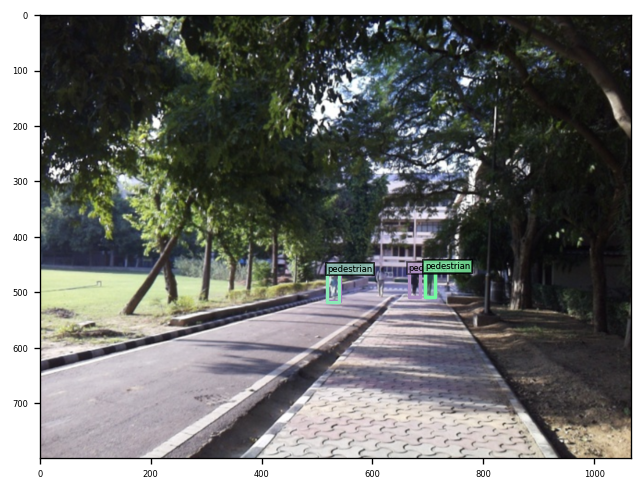

savename: /content/figs/finetuned_model_person_inference/pred_0006.png-37-2024-09-24-08:12:10.274173.png


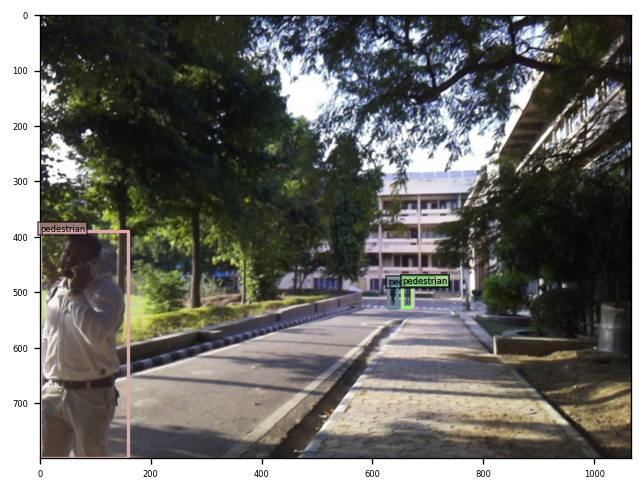

savename: /content/figs/finetuned_model_person_inference/pred_0007.png-39-2024-09-24-08:12:10.984631.png


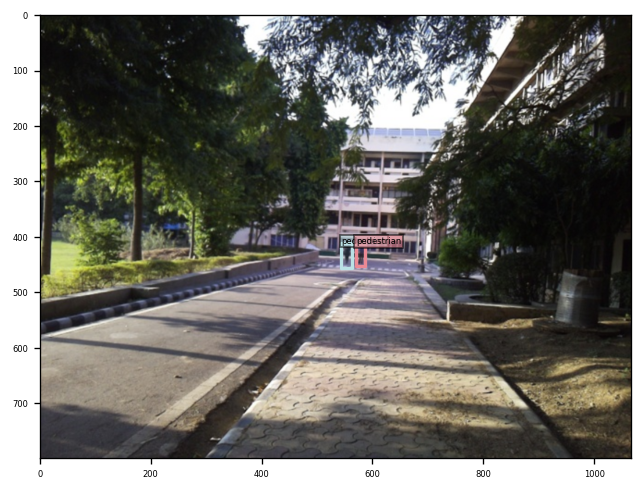

savename: /content/figs/finetuned_model_person_inference/pred_0008.png-40-2024-09-24-08:12:11.694935.png


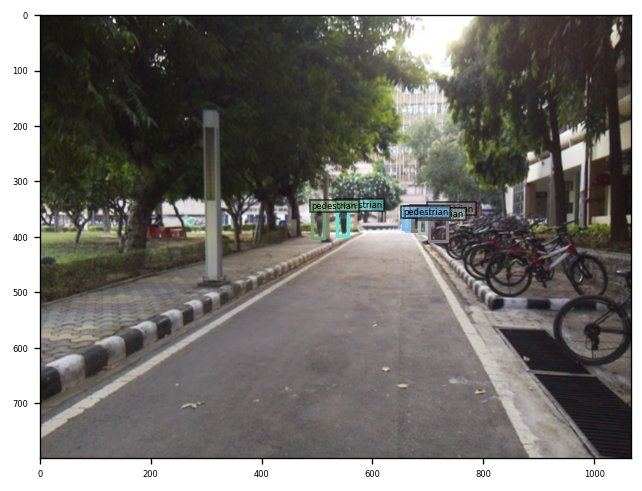

savename: /content/figs/finetuned_model_person_inference/pred_0009.png-47-2024-09-24-08:12:12.414282.png


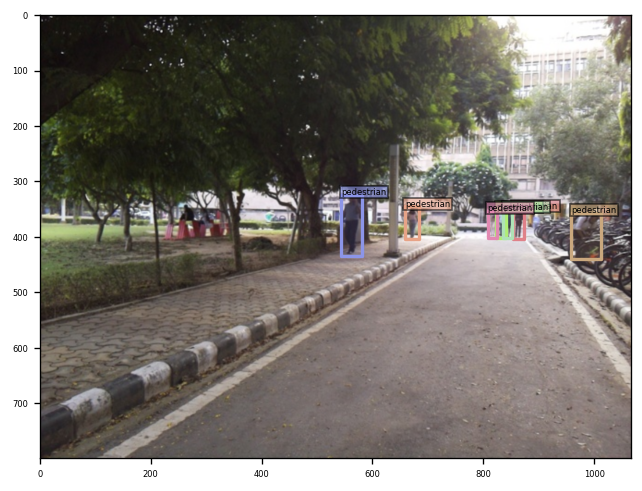

savename: /content/figs/finetuned_model_person_inference/pred_0010.png-48-2024-09-24-08:12:13.648119.png


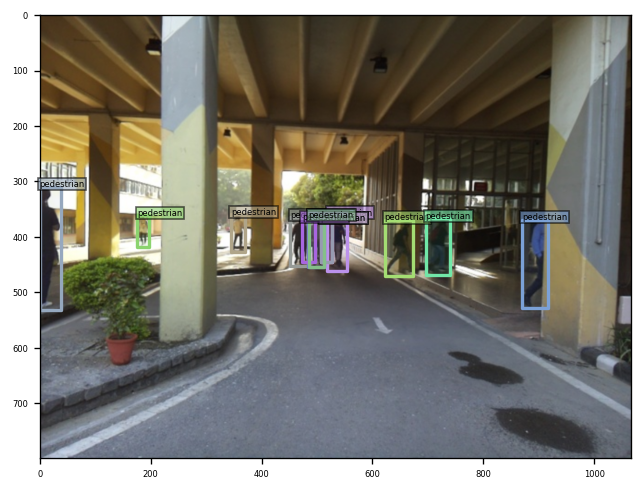

savename: /content/figs/finetuned_model_person_inference/pred_0011.png-58-2024-09-24-08:12:14.556080.png


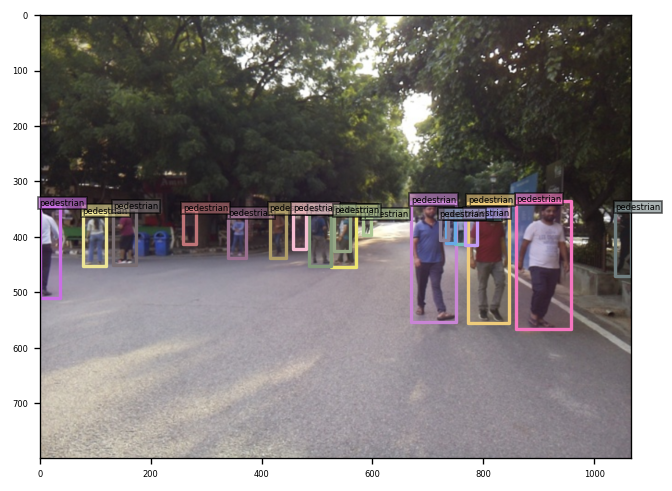

savename: /content/figs/finetuned_model_person_inference/pred_0012.png-63-2024-09-24-08:12:15.508001.png


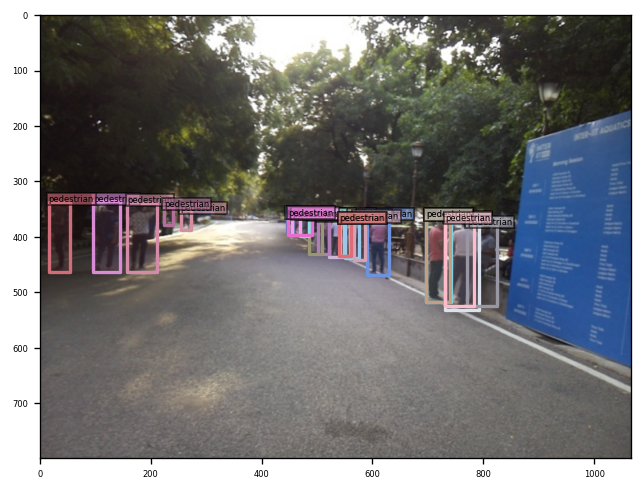

savename: /content/figs/finetuned_model_person_inference/pred_0013.png-65-2024-09-24-08:12:16.556816.png


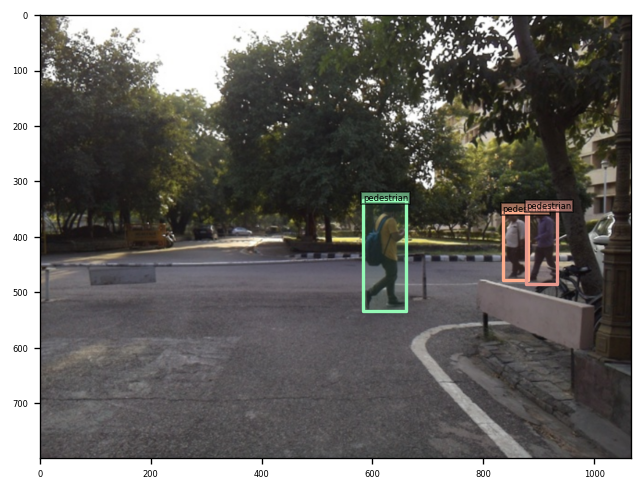

savename: /content/figs/finetuned_model_person_inference/pred_0014.png-72-2024-09-24-08:12:17.418872.png


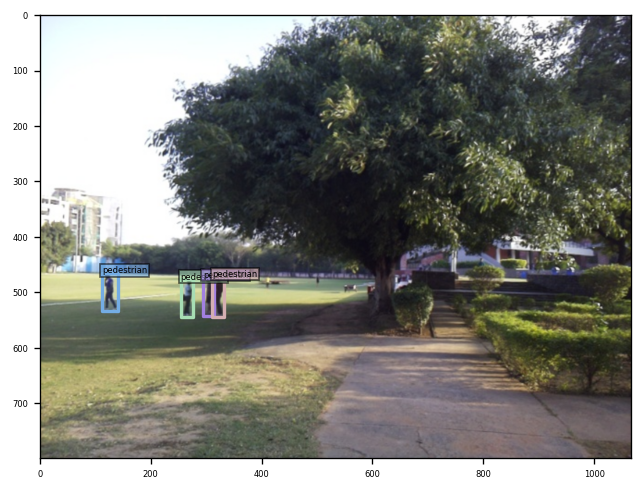

savename: /content/figs/finetuned_model_person_inference/pred_0015.png-79-2024-09-24-08:12:18.127184.png


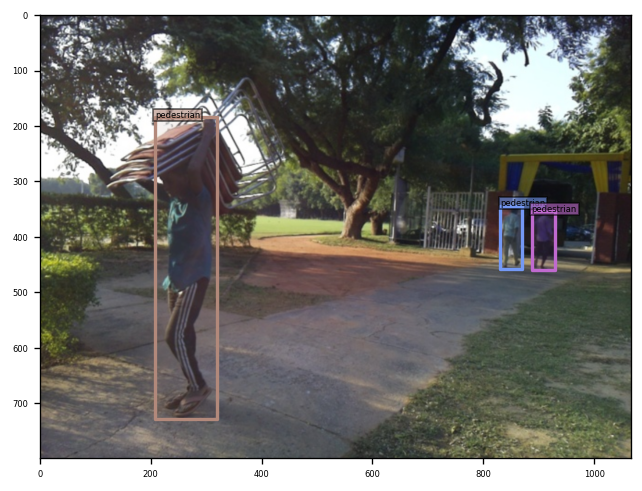

savename: /content/figs/finetuned_model_person_inference/pred_0016.png-85-2024-09-24-08:12:18.862614.png


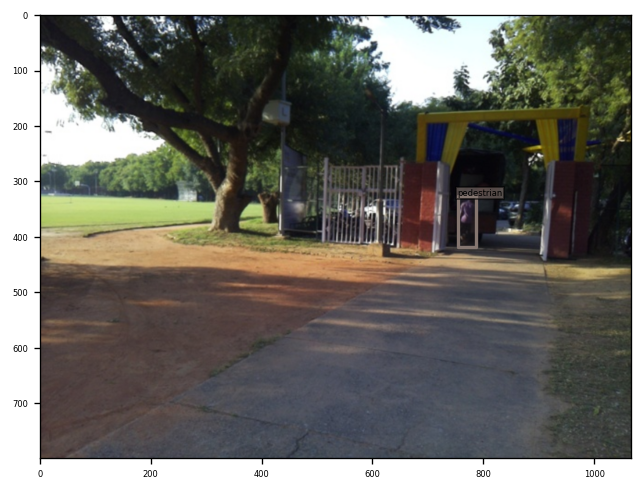

savename: /content/figs/finetuned_model_person_inference/pred_0017.png-88-2024-09-24-08:12:19.667033.png


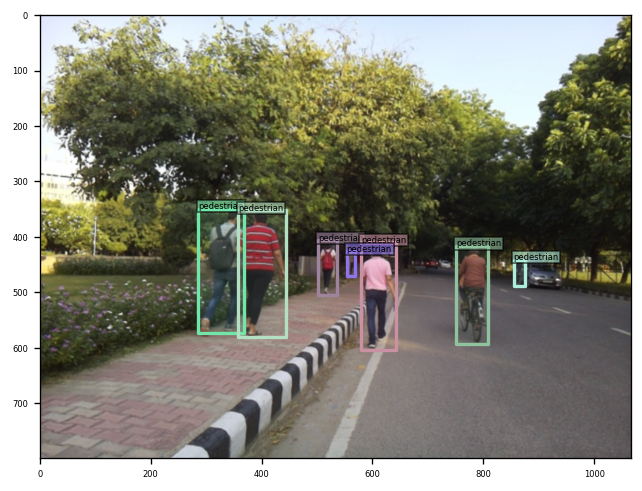

savename: /content/figs/finetuned_model_person_inference/pred_0018.png-96-2024-09-24-08:12:20.370571.png


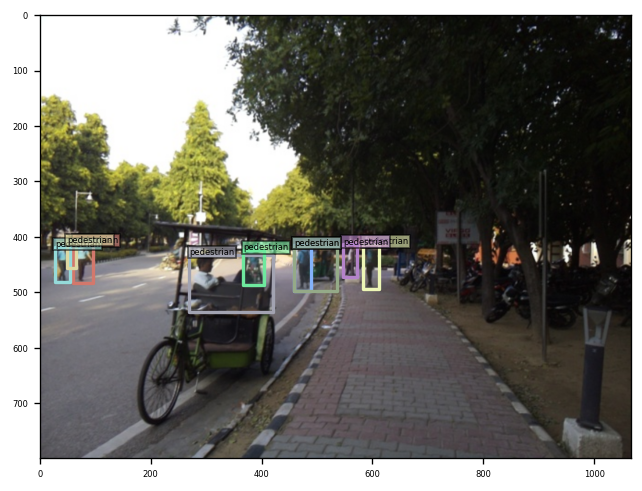

savename: /content/figs/finetuned_model_person_inference/pred_0019.png-103-2024-09-24-08:12:21.106862.png


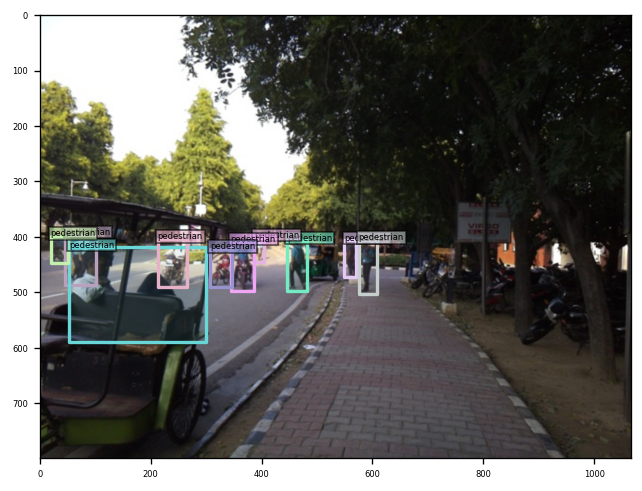

savename: /content/figs/finetuned_model_person_inference/pred_0020.png-106-2024-09-24-08:12:21.851267.png


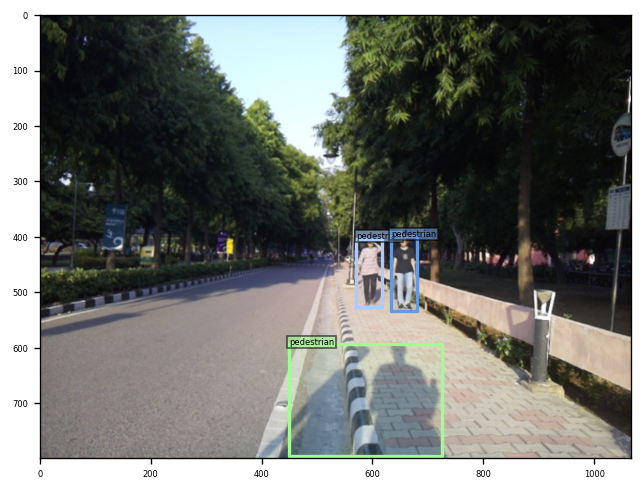

savename: /content/figs/finetuned_model_person_inference/pred_0021.png-119-2024-09-24-08:12:22.596830.png


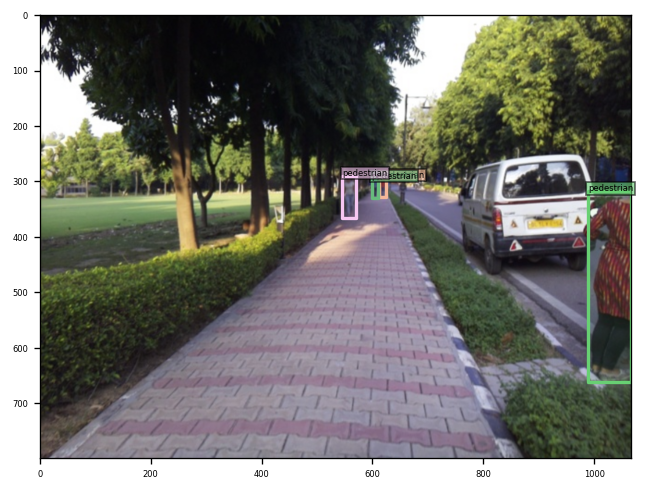

savename: /content/figs/finetuned_model_person_inference/pred_0022.png-131-2024-09-24-08:12:23.385746.png


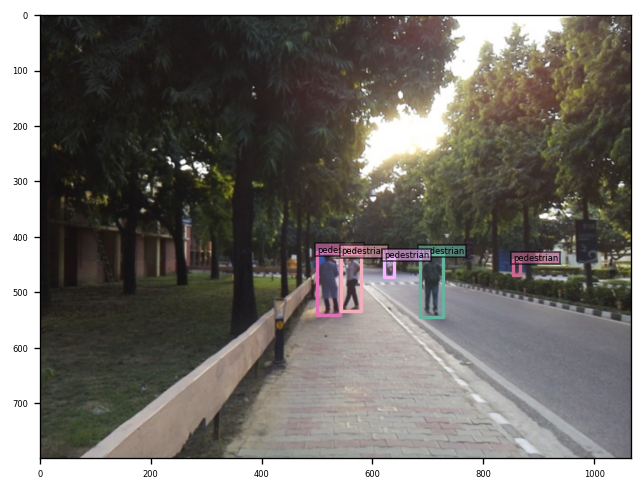

savename: /content/figs/finetuned_model_person_inference/pred_0023.png-134-2024-09-24-08:12:24.157867.png


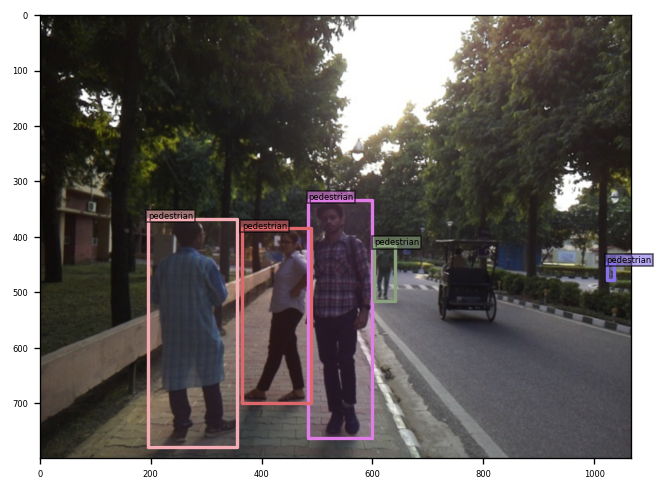

savename: /content/figs/finetuned_model_person_inference/pred_0024.png-135-2024-09-24-08:12:24.919575.png


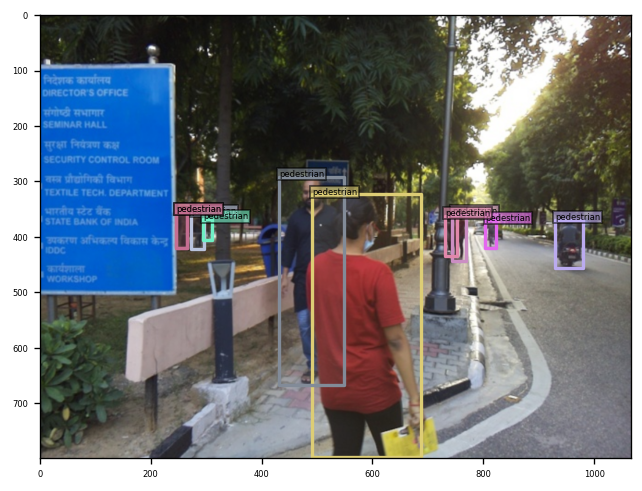

savename: /content/figs/finetuned_model_person_inference/pred_0025.png-142-2024-09-24-08:12:25.680663.png


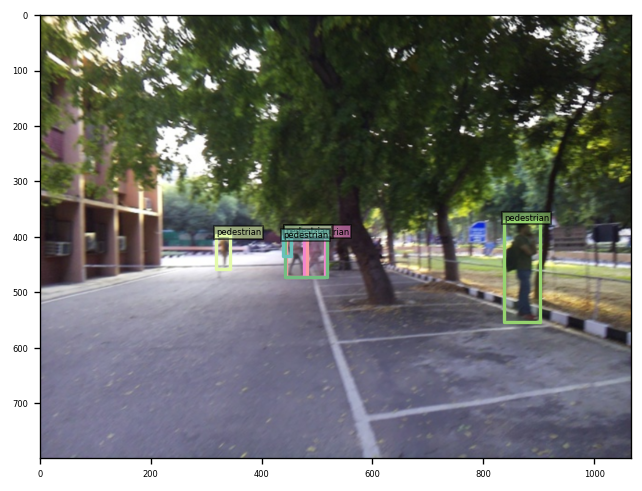

savename: /content/figs/finetuned_model_person_inference/pred_0026.png-149-2024-09-24-08:12:26.498856.png


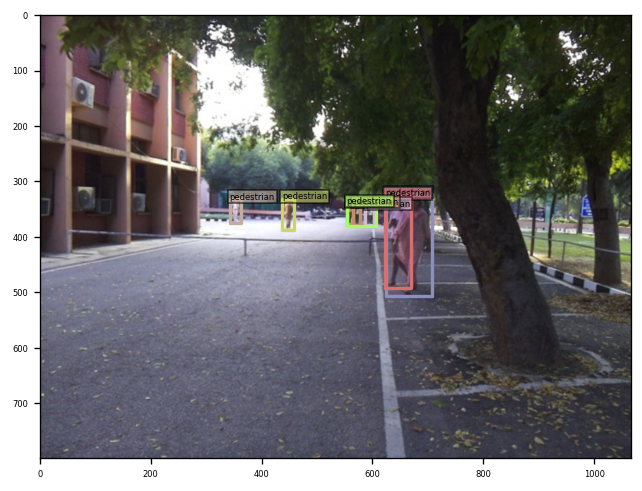

savename: /content/figs/finetuned_model_person_inference/pred_0027.png-151-2024-09-24-08:12:27.293380.png


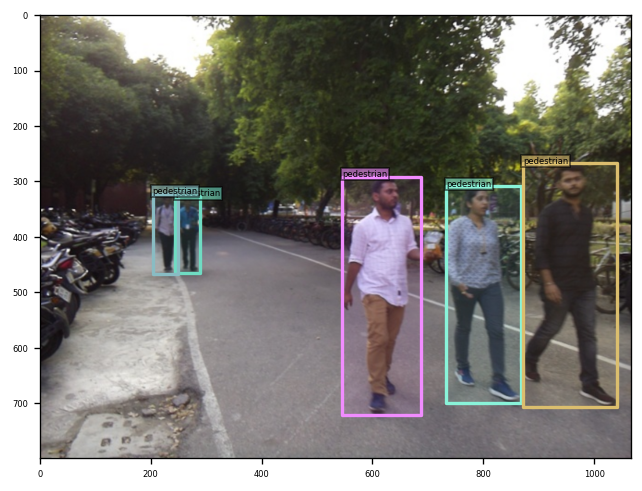

savename: /content/figs/finetuned_model_person_inference/pred_0028.png-153-2024-09-24-08:12:28.241707.png


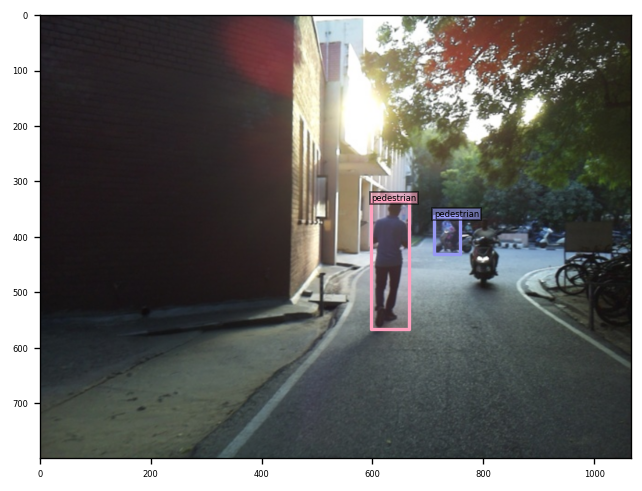

savename: /content/figs/finetuned_model_person_inference/pred_0029.png-157-2024-09-24-08:12:29.160344.png


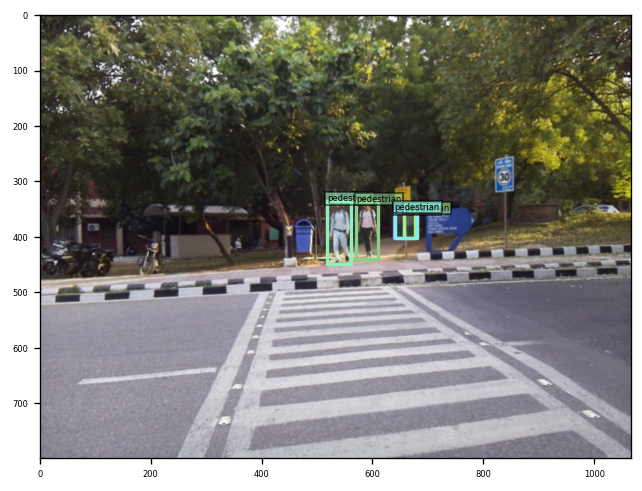

savename: /content/figs/finetuned_model_person_inference/pred_0030.png-161-2024-09-24-08:12:30.108110.png


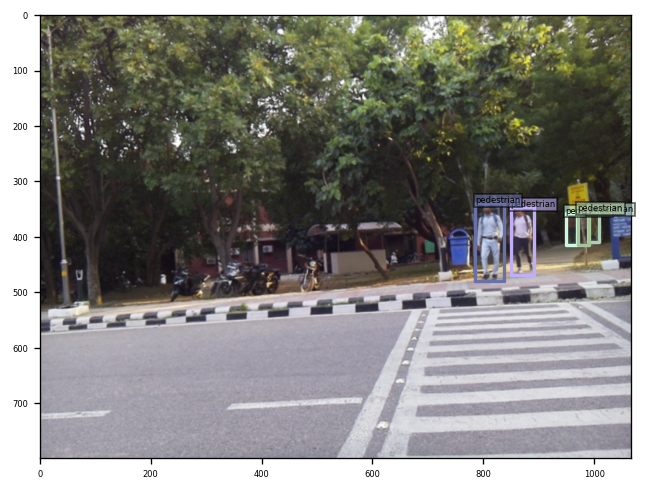

savename: /content/figs/finetuned_model_person_inference/pred_0031.png-164-2024-09-24-08:12:31.034209.png


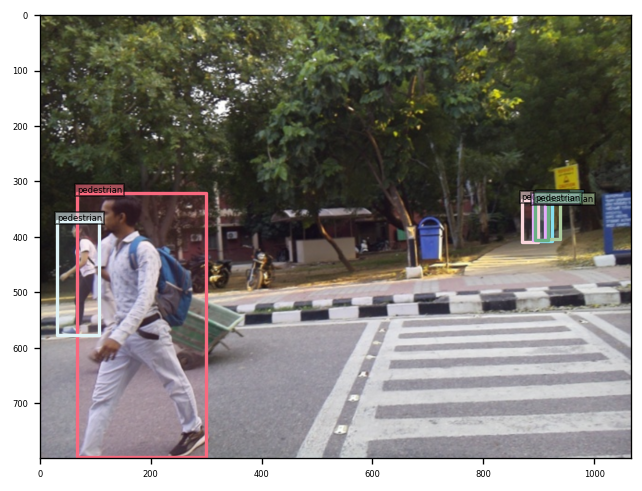

savename: /content/figs/finetuned_model_person_inference/pred_0032.png-169-2024-09-24-08:12:32.021301.png


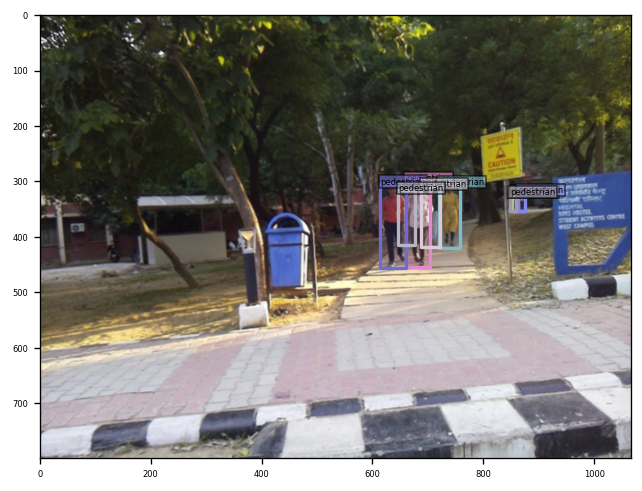

savename: /content/figs/finetuned_model_person_inference/pred_0033.png-174-2024-09-24-08:12:33.048827.png


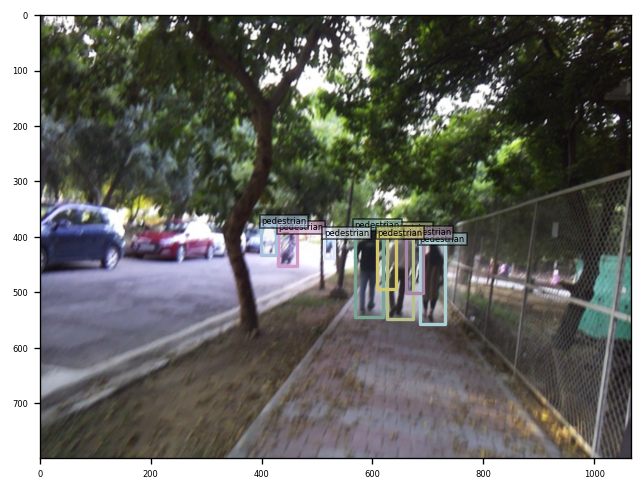

savename: /content/figs/finetuned_model_person_inference/pred_0034.png-186-2024-09-24-08:12:34.101836.png


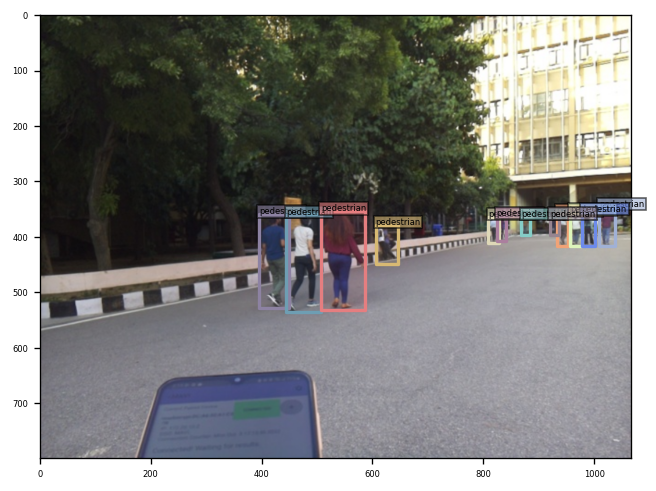

savename: /content/figs/finetuned_model_person_inference/pred_0035.png-191-2024-09-24-08:12:35.091520.png


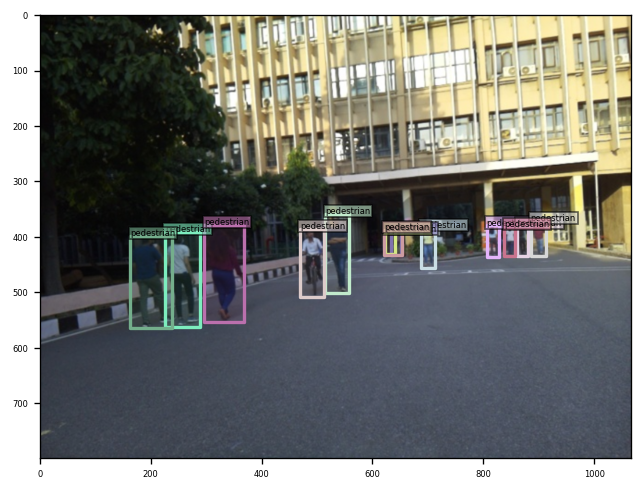

savename: /content/figs/finetuned_model_person_inference/pred_0036.png-195-2024-09-24-08:12:35.976479.png


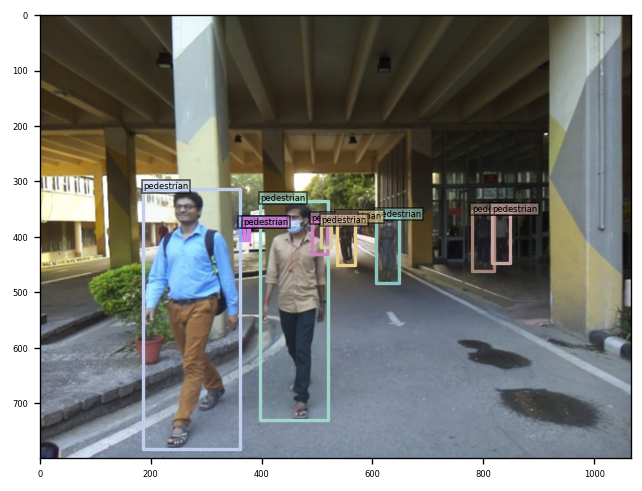

savename: /content/figs/finetuned_model_person_inference/pred_0037.png-196-2024-09-24-08:12:36.868458.png


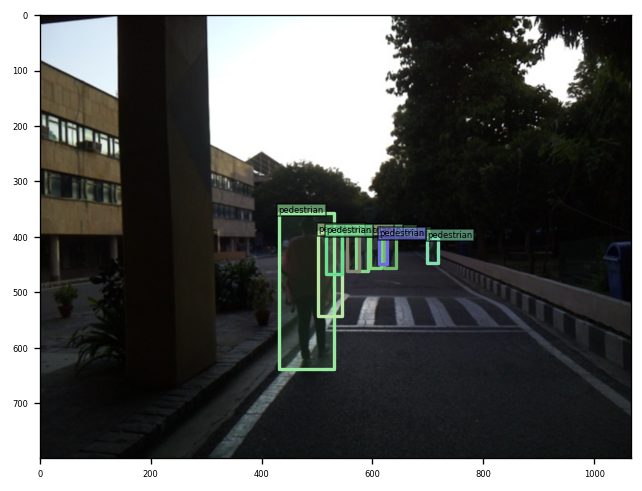

savename: /content/figs/finetuned_model_person_inference/pred_0038.png-197-2024-09-24-08:12:37.669853.png


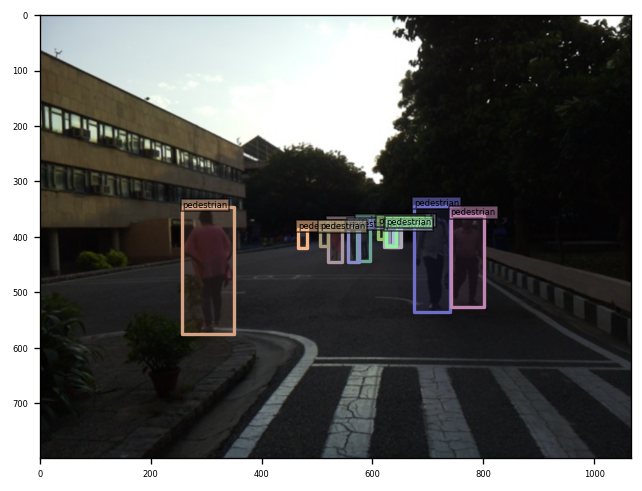

savename: /content/figs/finetuned_model_person_inference/pred_0039.png-199-2024-09-24-08:12:38.452931.png
Error idx: 40


In [ ]:
import os, sys
import torch, json
import numpy as np

from main import build_model_main
from util.slconfig import SLConfig
from datasets import build_dataset
from util.visualizer import COCOVisualizer
from util import box_ops

# Paths for the model config and checkpoint files
model_config_path = "/content/config/DINO/DINO_4scale.py"  # Path to the model config file
model_checkpoint_path = "/content/output/DINO/R50-MS4/checkpoint_best_regular.pth"  # Fine-tuned model checkpoint

# Load the model configuration and set device to CUDA
args = SLConfig.fromfile(model_config_path)
args.device = 'cuda'
model, criterion, postprocessors = build_model_main(args)

# Load the fine-tuned model checkpoint
checkpoint = torch.load(model_checkpoint_path, map_location='cpu')
model.load_state_dict(checkpoint['model'])
_ = model.eval()

# 1. Visualize images from a dataloader
# 1.1 Load Custom Dataset
args.dataset_file = 'coco'  # Set the format according to your custom dataset
args.coco_path = "/content/custom_dataset"  # Path to your custom dataset
args.fix_size = False

# Build the validation dataset
dataset_val = build_dataset(image_set='val', args=args)

# Inference on dataset
for i,batch in enumerate(dataset_val):
    image, targets = batch  # Image and target from dataset

    # Forward pass through the model
    output = model.cuda()(image[None].cuda())
    output = postprocessors['bbox'](output, torch.Tensor([[1.0, 1.0]]).cuda())[0]

    threshold = 0.3  # Set the confidence threshold

    scores = output['scores']
    labels = output['labels']
    boxes = box_ops.box_xyxy_to_cxcywh(output['boxes'])

    # Since there's only one class (pedestrian), we assume all predictions are for pedestrians
    select_mask = scores > threshold  # Only select predictions above the threshold

    # Prepare the predicted output dictionary
    pred_dict = {
        'boxes': boxes[select_mask],
        'size': targets['size'],
        'image_id': targets['image_id'],
        'box_label': ['pedestrian'] * select_mask.sum().item()  # Label all detections as 'pedestrian'
    }

    # Visualize the result
    vslzr = COCOVisualizer()
    vslzr.visualize(image, pred_dict, caption=f"pred_{str(i).zfill(4)}.png",savedir='/content/figs/finetuned_model_person_inference')  # Set savedir to save or None to just display


In [ ]:
!rm /content/figs/pre_trained_model_person_inference -r